<a href="https://colab.research.google.com/github/ajitjadhav10/UMBC/blob/main/Capstone/Capstone_project_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [126]:
pip install librosa --quiet

In [127]:
import matplotlib.pyplot as plt
%matplotlib inline
import IPython.display as ipd
import librosa
import librosa.display
from glob import glob
import numpy as np

In [128]:
dr='/content/drive/MyDrive/Capstone/emergency_sounds'

In [129]:
#Count of audio files in emergency sounds dataset

audio_files=glob(dr+'/*.wav')

len(audio_files)

110

In [130]:
dr_2='/content/drive/MyDrive/Capstone/general_sounds'

In [131]:
#Count of audio files in non emergency sounds dataset

general_audio_files=glob(dr_2+'/*.wav')

len(general_audio_files)

119

## General stats of the non-emergency and emergency audio dataset
- Mean, maximum and minimum duration of clips in the dataset is displayed below

In [132]:
#Non emergency sounds stats

durations = [librosa.get_duration(filename=p) for p in general_audio_files]

stats = {
    'mean': np.mean(durations),
    'max': np.max(durations),
    'min': np.min(durations),
}

print(stats)

<ipython-input-132-a801cd8a2c21>:3: FutureWarning: get_duration() keyword argument 'filename' has been renamed to 'path' in version 0.10.0.
	This alias will be removed in version 1.0.
  durations = [librosa.get_duration(filename=p) for p in general_audio_files]


{'mean': 37.090899126317204, 'max': 370.6775625, 'min': 0.7314375}


In [133]:
#Emergency sounds stats

durations = [librosa.get_duration(filename=p) for p in audio_files]

stats = { 'mean': np.mean(durations), 'max': np.max(durations), 'min': np.min(durations)}
print(stats)

<ipython-input-133-4465ec4b24fa>:3: FutureWarning: get_duration() keyword argument 'filename' has been renamed to 'path' in version 0.10.0.
	This alias will be removed in version 1.0.
  durations = [librosa.get_duration(filename=p) for p in audio_files]


{'mean': 33.26022735776129, 'max': 272.0391875, 'min': 1.6457291666666667}


## Plotting the amplitude of all the audio files in emergency sounds folder against time


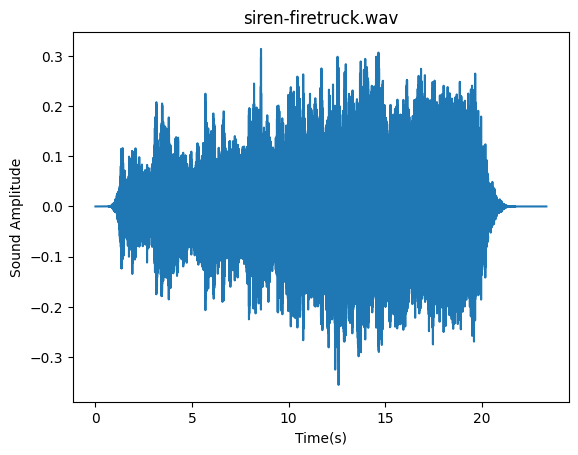

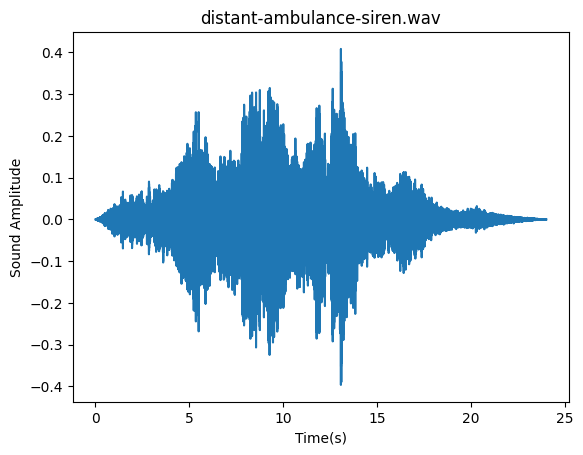

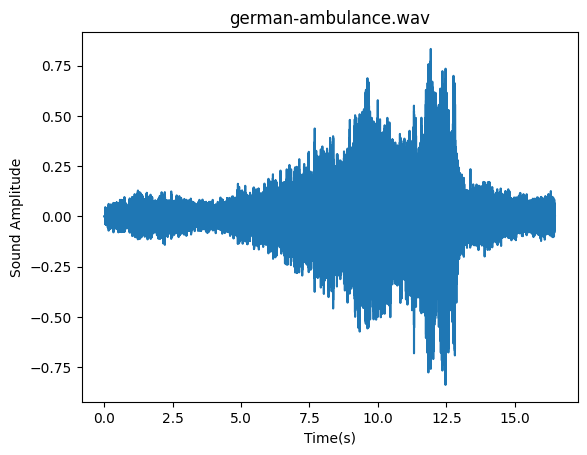

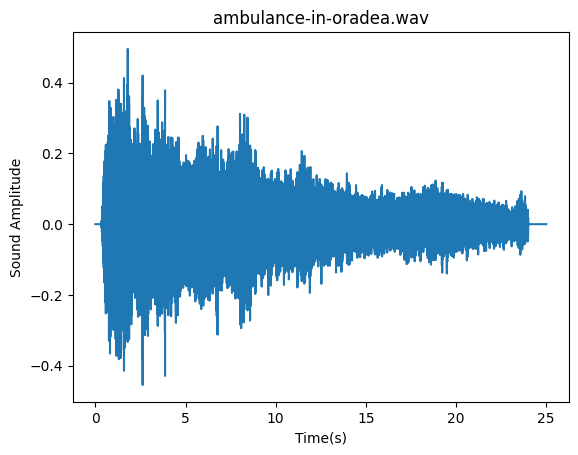

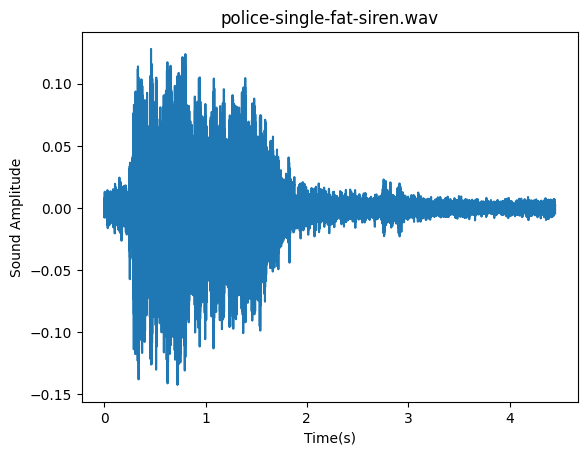

...

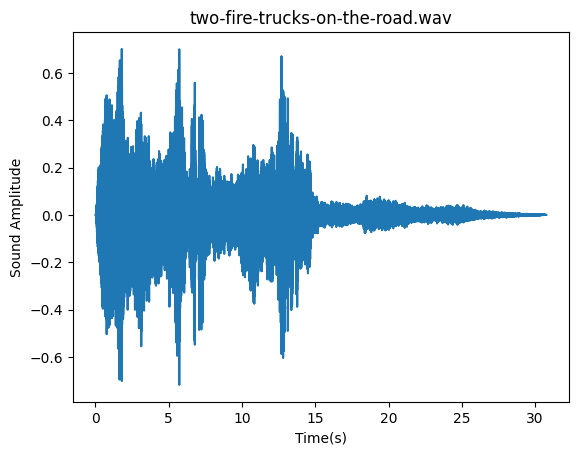

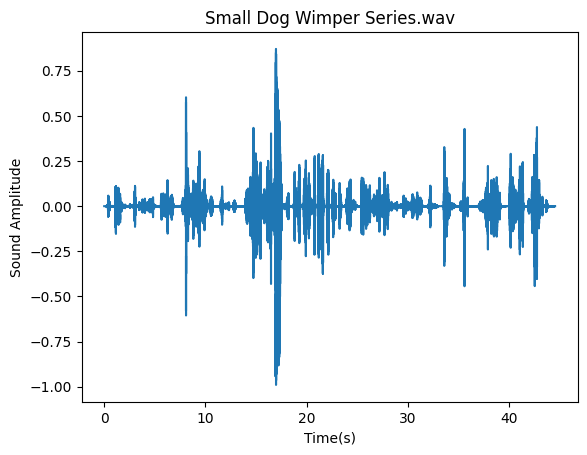

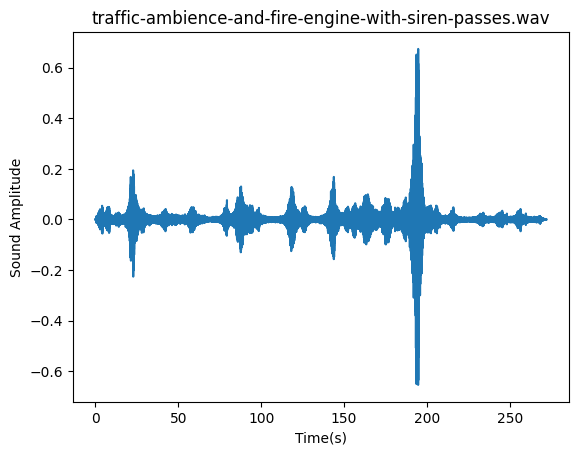

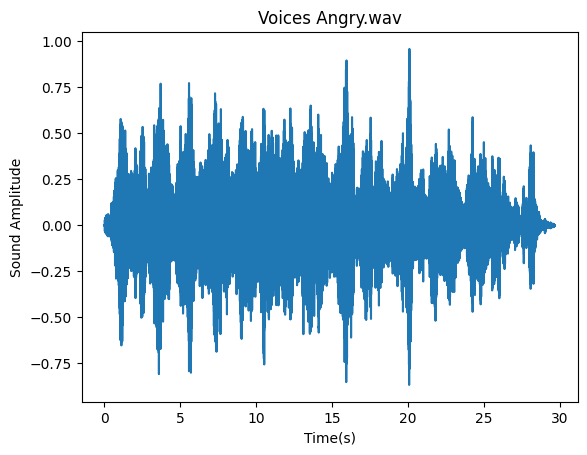

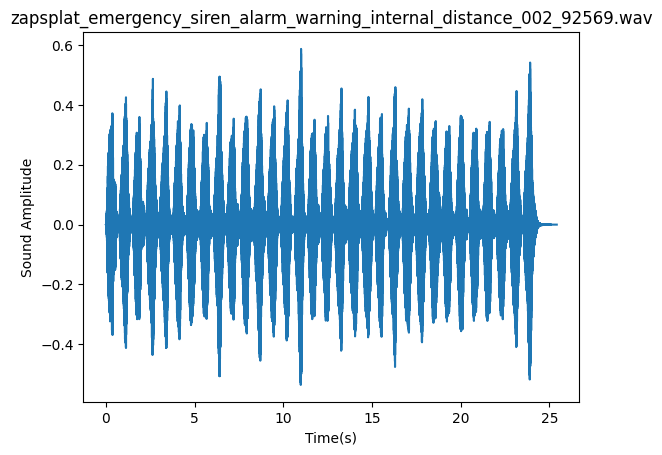

CPU times: user 58.3 s, sys: 11.1 s, total: 1min 9s
Wall time: 1min 8s


In [134]:
%%time

for file in range(0,len(audio_files),1):
  audio,sfreq=librosa.load(audio_files[file])
  time=np.arange(0,len(audio))/sfreq

  #Plotting audio over time
  fig, ax=plt.subplots()
  ax.plot(time,audio)
  ax.set(xlabel='Time(s)', ylabel='Sound Amplitude')
  plt.title(audio_files[file].split("/")[-1])
  plt.show()


In [135]:
general_audio_files

['/content/drive/MyDrive/Capstone/general_sounds/fumfumfum-whistled (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/fumfumfum-whistled.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/small-bell.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell-2.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/christmas-fireworks.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/jingle-bells-various-length.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/christmas-angel-chimes.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/street-ambience-on-christmas.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/small-bell (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell-2 (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/church-bells-1.wav',
 '/content/dri

## Plotting the amplitude of all non-emergency sounds against time

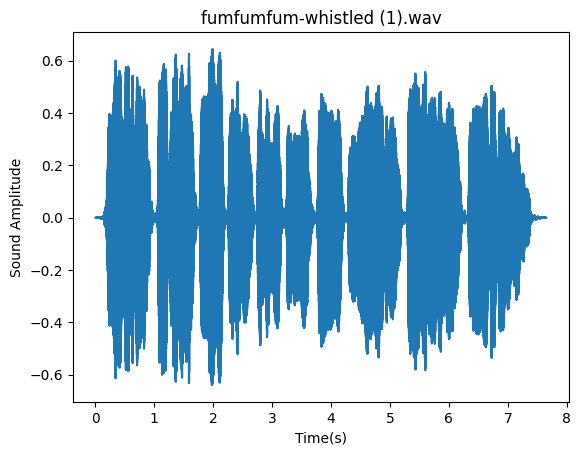

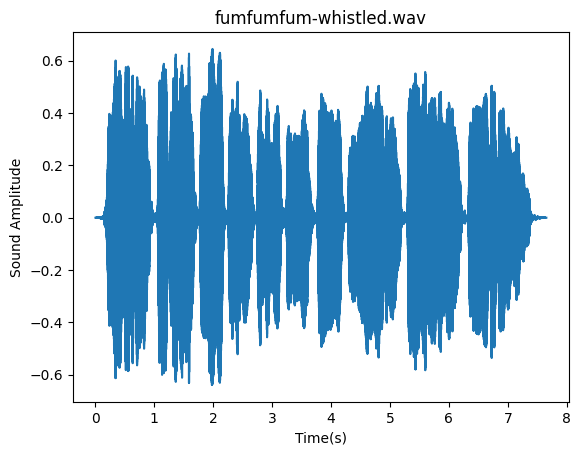

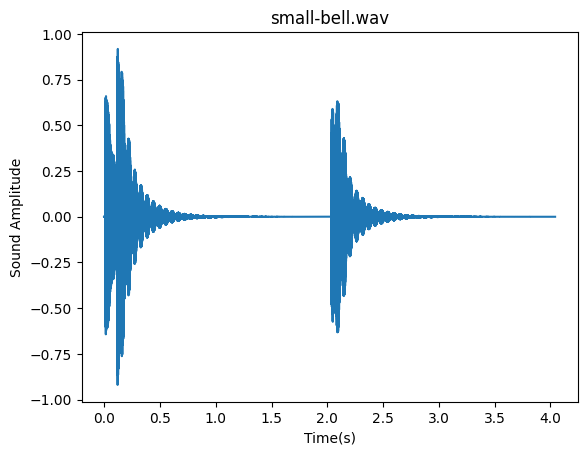

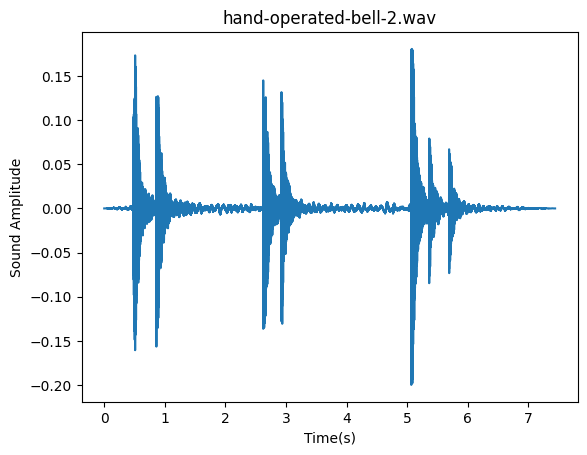

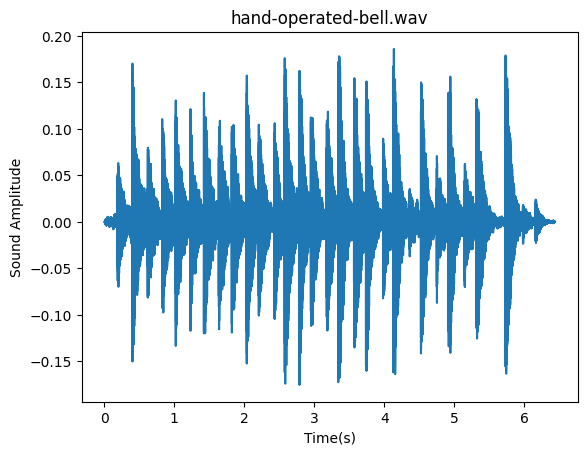

...

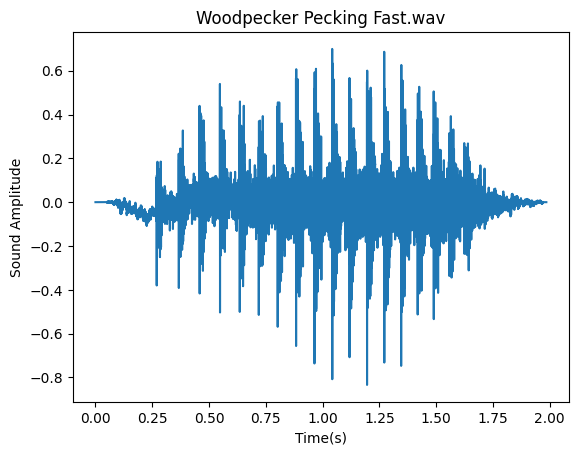

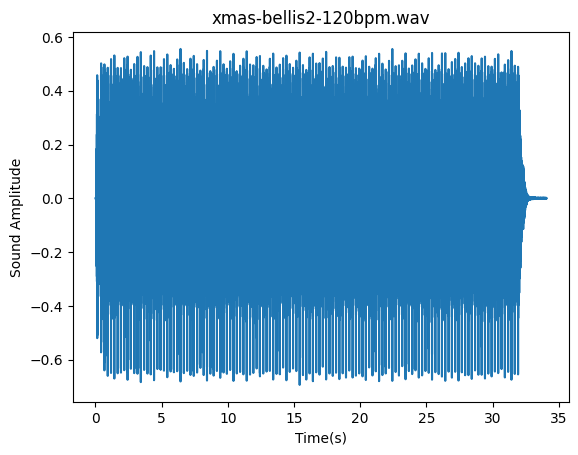

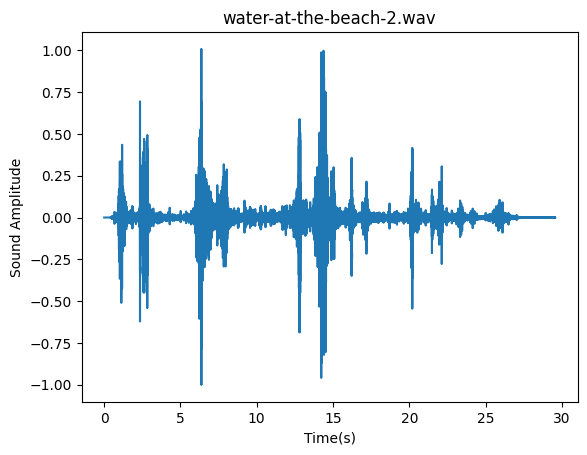

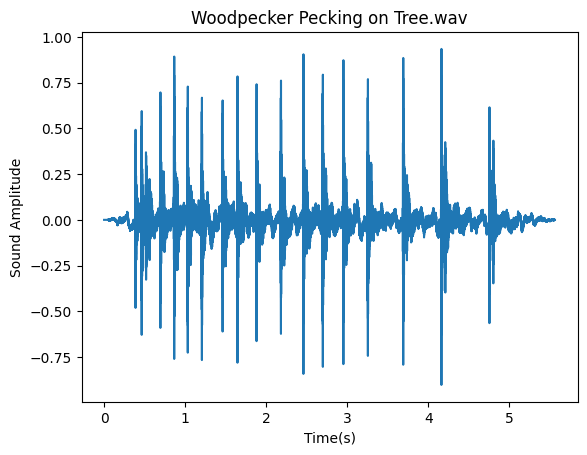

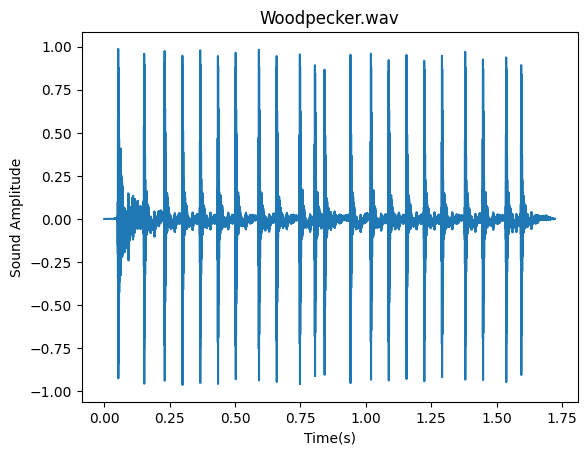

CPU times: user 1min 1s, sys: 13.3 s, total: 1min 14s
Wall time: 1min 9s


In [136]:
%%time

for file in range(0,len(general_audio_files),1):
  audio,sfreq=librosa.load(general_audio_files[file])
  time=np.arange(0,len(audio))/sfreq

  #Plotting audio over time
  fig, ax=plt.subplots()
  ax.plot(time,audio)
  ax.set(xlabel='Time(s)', ylabel='Sound Amplitude')
  plt.title(general_audio_files[file].split("/")[-1])
  plt.show()
  ipd.Audio(general_audio_files[file])

## Spectograms

- Spectogram displays the intensity of the frequency of the audio clip

General audio Spectograms

In [137]:
#Following are the audio files in non emergency audio category

general_audio_files

['/content/drive/MyDrive/Capstone/general_sounds/fumfumfum-whistled (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/fumfumfum-whistled.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/small-bell.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell-2.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/christmas-fireworks.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/jingle-bells-various-length.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/christmas-angel-chimes.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/street-ambience-on-christmas.wav',
 '/content/drive/MyDrive/Capstone/general_sounds/small-bell (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell-2 (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/hand-operated-bell (1).wav',
 '/content/drive/MyDrive/Capstone/general_sounds/church-bells-1.wav',
 '/content/dri

In [138]:
y, sr = librosa.load(general_audio_files[2])

In [139]:
D = librosa.stft(y)
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
S_db.shape

(1025, 175)

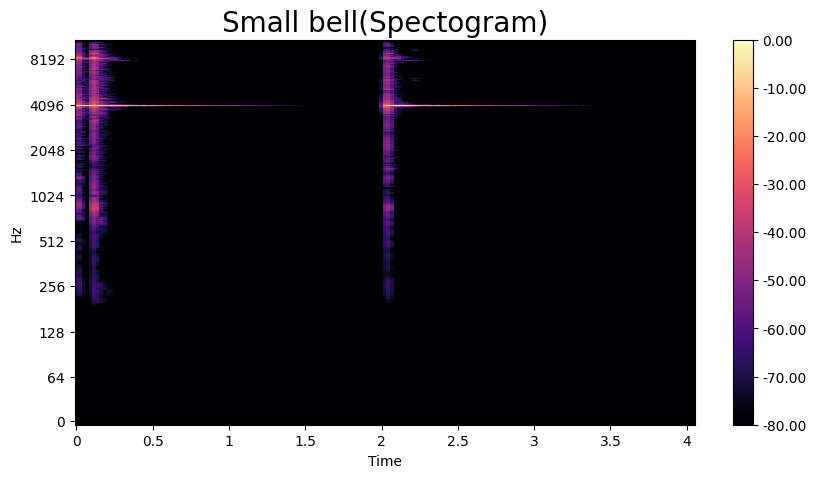

In [140]:
fig, ax = plt.subplots(figsize=(10, 5))
img = librosa.display.specshow(S_db,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Small bell(Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(general_audio_files[2])

In the above spectogram we can see that the audio has frequencies in the range of around 256 Hz to a little bit over 8200 Hz followed by a silence of around 0.5 seconds then similar frequencies are repeated

In [141]:
x, sr1 = librosa.load(general_audio_files[50])
D = librosa.stft(x)
S_db_1 = librosa.amplitude_to_db(np.abs(D), ref=np.max)
S_db_1.shape

(1025, 372)

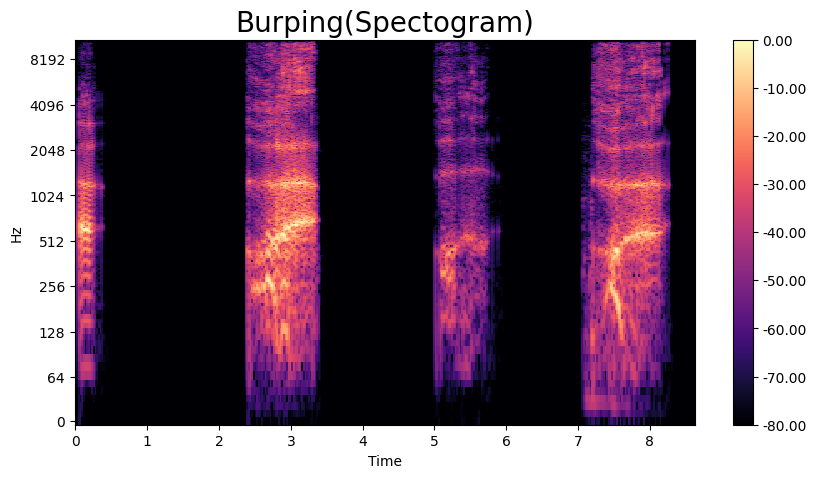

In [142]:
fig, ax = plt.subplots(figsize=(10, 5))
img = librosa.display.specshow(S_db_1,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Burping(Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(general_audio_files[50])

In the above spectogram we can see that the audio has frequencies in the range of around 64 Hz to a little bit over 8200 Hz with around 2 seconds of silence between each one of them.

Emergency audio Spectograms

In [143]:
#Following are the audio files in emergency audio category

audio_files

['/content/drive/MyDrive/Capstone/emergency_sounds/siren-firetruck.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/distant-ambulance-siren.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/german-ambulance.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/ambulance-in-oradea.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/police-single-fat-siren.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/one-police-siren-with-long-tail.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/emergency-siren-police-moving.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/police-in-paris.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/siren-police-approach.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/siren-police-pass-002.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/siren-police-misc-stationary.wav',
 '/content/drive/MyDrive/Capstone/emergency_sounds/police-siren-start-away.wav',
 '/content/drive/MyDrive/Capstone/emerge

In [144]:
u, sr = librosa.load(audio_files[1])
D = librosa.stft(u)
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
S_db.shape

(1025, 1034)

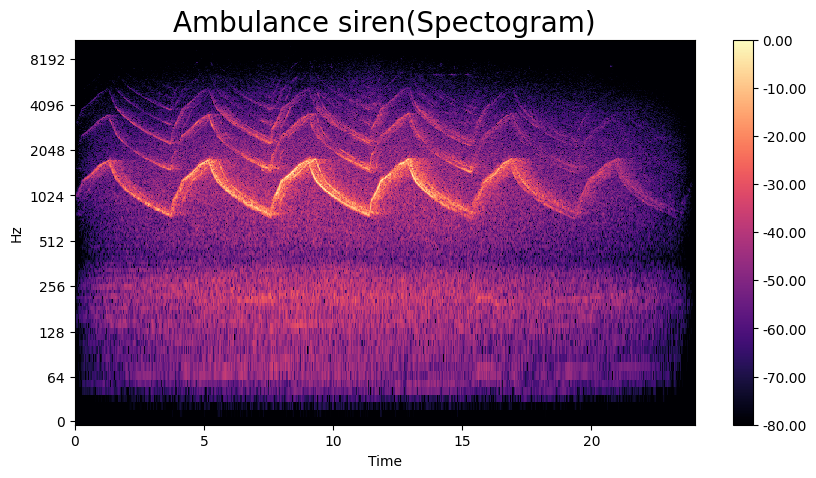

In [145]:
fig, ax = plt.subplots(figsize=(10, 5))
img = librosa.display.specshow(S_db,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Ambulance siren(Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(audio_files[1])

In [146]:
v, sr = librosa.load(audio_files[20])
D = librosa.stft(v)
S_db_1 = librosa.amplitude_to_db(np.abs(D), ref=np.max)
S_db_1.shape

(1025, 690)

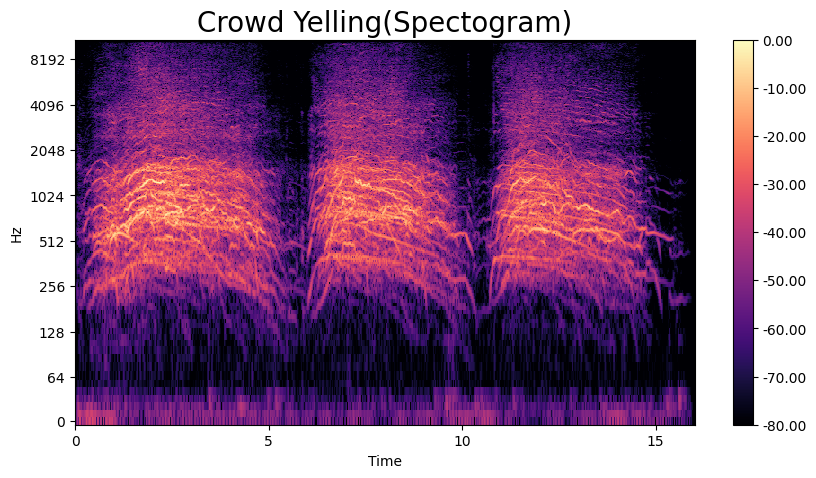

In [147]:
fig, ax = plt.subplots(figsize=(10, 5))
img = librosa.display.specshow(S_db_1,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Crowd Yelling(Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(audio_files[20])

## Mel Spectogram

- Humans do not perceive frequencies linearly. We are more sensitive to differences between lower frequencies than higher frequencies.

- For example, the difference between 100Hz and 200Hz will sound further apart than between 1000Hz and 1100Hz. And you will hardly be able to distinguish between 10000Hz and 10100Hz.

- This is how humans perceive frequencies. We hear them on a logarithmic scale rather than a linear scale.

- So inorder to take this into account, the Mel scale was developed. It is a scale of pitches, such that each unit is judged by listeners to be equal in pitch distance from the next.

General audio Mel Spectogram


In [148]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128 * 2,) 
S_db_mel = librosa.amplitude_to_db(S, ref=np.max)

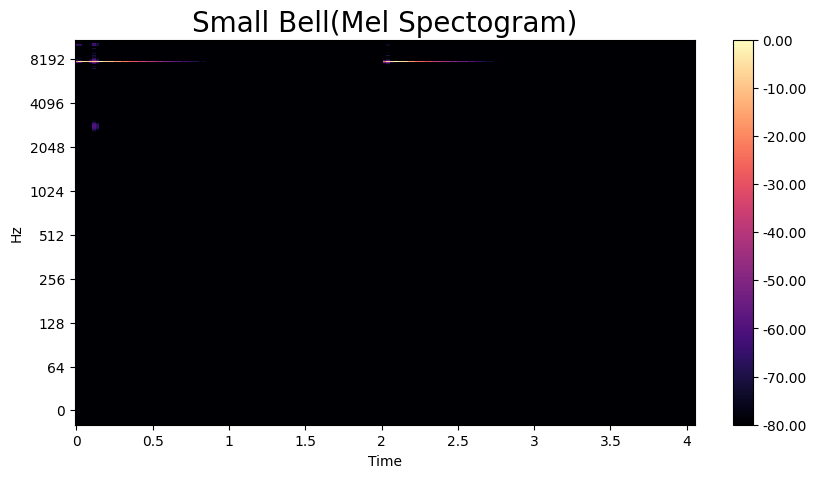

In [149]:
fig, ax = plt.subplots(figsize=(10, 5))
# Plot the mel spectogram
img = librosa.display.specshow(S_db_mel,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Small Bell(Mel Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(general_audio_files[2])

Emergency audio Mel Spectogram

In [150]:
S = librosa.feature.melspectrogram(y=u, sr=sr, n_mels=128 * 2,) 
S_db_mel = librosa.amplitude_to_db(S, ref=np.max)

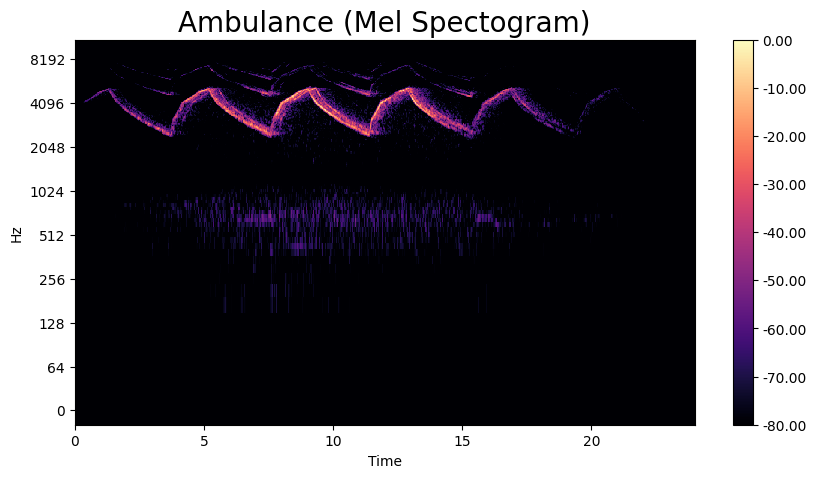

In [151]:
fig, ax = plt.subplots(figsize=(10, 5))
# Plot the mel spectogram
img = librosa.display.specshow(S_db_mel,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Ambulance (Mel Spectogram)', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()
ipd.Audio(audio_files[1])

In [ ]:
#Do not refer beyond this comment

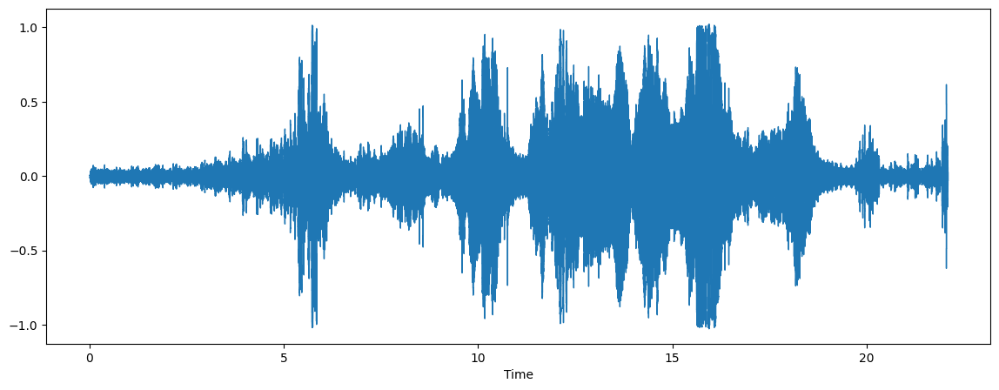

In [8]:
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename_1)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename_1)

In [4]:
filename_1='/content/drive/MyDrive/Capstone/emergency_sounds/8-police-cars-passing-w-sirens.wav'
filename_2='/content/drive/MyDrive/Capstone/emergency_sounds/Big Gun Shots Close (1).wav'

filename_3='/content/drive/MyDrive/Capstone/general_sounds/Baby Heavy Breaths (1).wav'
filename_4='/content/drive/MyDrive/Capstone/general_sounds/Crowd Talking.wav'

In [12]:
!pwd

/content


In [13]:
import os

In [14]:
os.chdir('/content/drive/MyDrive/Capstone/emergency_sounds')